<a href="https://colab.research.google.com/github/neetmadann/neetmadan.github.io/blob/main/Urban_Form_Short_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Urban Form Exploration

In [ ]:
#Import all packages

In [ ]:
import pandas as pd
import numpy as np
import datetime as dt
import seaborn as sns
import matplotlib
import os
import matplotlib.pyplot as plt
import matplotlib.dates as md
import pandas as pd
import matplotlib.pyplot as plt #if using matplotlib
import plotly.express as px #if using plotly
import geopandas as gpd
import warnings

import momepy

import warnings

import geopandas
import libpysal
import momepy
import osmnx
import pandas

In [ ]:
# set the filepath and load in a shapefile
fp = r'MSOA.geojson'
map_df = gpd.read_file(fp)
map_df.head()

,OBJECTID,MSOA11CD,MSOA11NM,BNG_E,BNG_N,LONG_,LAT,Shape_Leng,Shape__Area,Shape__Length,geometry
0,1,E02000001,City of London 001,532384,181355,-0.093490,51.5156,9651.221144,3.151475e+06,9651.221144,"POLYGON ((-0.09650 51.52295, -0.09644 51.52282..."
1,2,E02000002,Barking and Dagenham 001,548267,189685,0.138756,51.5865,8306.888230,2.161561e+06,8306.888230,"POLYGON ((0.14810 51.59656, 0.14809 51.59640, ..."
2,3,E02000003,Barking and Dagenham 002,548259,188520,0.138149,51.5760,9359.512342,2.141515e+06,9359.512342,"POLYGON ((0.14847 51.58083, 0.14841 51.58075, ..."
3,4,E02000004,Barking and Dagenham 003,551004,186412,0.176828,51.5564,8475.840309,2.492946e+06,8475.840309,"POLYGON ((0.18511 51.56480, 0.18479 51.56455, ..."
4,5,E02000005,Barking and Dagenham 004,548733,186824,0.144267,51.5607,7321.657104,1.187954e+06,7321.657104,"POLYGON ((0.15187 51.56778, 0.15193 51.56775, ..."


In [ ]:
eng_df = map_df[map_df['MSOA11CD'].str[0]=='E'] 

In [ ]:
len(eng_df)

6791

<AxesSubplot: >

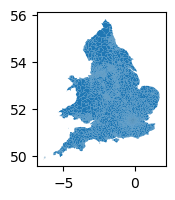

In [ ]:
map_df.plot(figsize=(2, 2),linewidth=0.01)

In [ ]:
eng_df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
eng_df.to_crs('EPSG:27700')

,OBJECTID,MSOA11CD,MSOA11NM,BNG_E,BNG_N,LONG_,LAT,Shape_Leng,Shape__Area,Shape__Length,geometry
0,1,E02000001,City of London 001,532384,181355,-0.093490,51.5156,9651.221144,3.151475e+06,9651.221144,"POLYGON ((532153.715 182165.158, 532158.262 18..."
1,2,E02000002,Barking and Dagenham 001,548267,189685,0.138756,51.5865,8306.888230,2.161561e+06,8306.888230,"POLYGON ((548881.317 190819.983, 548881.138 19..."
2,3,E02000003,Barking and Dagenham 002,548259,188520,0.138149,51.5760,9359.512342,2.141515e+06,9359.512342,"POLYGON ((548958.570 189072.181, 548954.531 18..."
3,4,E02000004,Barking and Dagenham 003,551004,186412,0.176828,51.5564,8475.840309,2.492946e+06,8475.840309,"POLYGON ((551550.071 187364.710, 551528.648 18..."
4,5,E02000005,Barking and Dagenham 004,548733,186824,0.144267,51.5607,7321.657104,1.187954e+06,7321.657104,"POLYGON ((549237.064 187627.944, 549241.332 18..."
...,...,...,...,...,...,...,...,...,...,...,...
6819,6820,E02006930,Greenwich 037,540126,178333,0.016812,51.4866,8103.297524,8.674410e+05,8103.297524,"MULTIPOLYGON (((540659.012 178728.004, 540601...."
6820,6821,E02006931,Greenwich 038,538710,177146,-0.004030,51.4763,9351.043860,2.049169e+06,9351.043860,"POLYGON ((538710.355 177960.764, 538716.506 17..."
6821,6822,E02006932,Liverpool 060,334899,390314,-2.980710,53.4056,12791.918754,1.477077e+06,12791.918754,"POLYGON ((335723.013 391178.004, 335737.225 39..."
6822,6823,E02006933,Liverpool 061,334647,389248,-2.984270,53.3960,10815.142852,2.824636e+06,10815.142852,"POLYGON ((335092.922 390247.027, 335096.012 39..."


In [ ]:
eng_df['geometry']

0       POLYGON ((-0.09650 51.52295, -0.09644 51.52282...
1       POLYGON ((0.14810 51.59656, 0.14809 51.59640, ...
2       POLYGON ((0.14847 51.58083, 0.14841 51.58075, ...
3       POLYGON ((0.18511 51.56480, 0.18479 51.56455, ...
4       POLYGON ((0.15187 51.56778, 0.15193 51.56775, ...
                              ...                        
6819    MULTIPOLYGON (((0.02464 51.49001, 0.02381 51.4...
6820    POLYGON ((-0.00371 51.48360, -0.00363 51.48350...
6821    POLYGON ((-2.96849 53.41349, -2.96827 53.41305...
6822    POLYGON ((-2.97778 53.40505, -2.97773 53.40505...
6823    POLYGON ((-2.98433 53.41662, -2.98426 53.41651...
Name: geometry, Length: 6791, dtype: geometry

In [ ]:
eng_df[eng_df['MSOA11CD']=='E02000001']

,OBJECTID,MSOA11CD,MSOA11NM,BNG_E,BNG_N,LONG_,LAT,Shape_Leng,Shape__Area,Shape__Length,geometry
0,1,E02000001,City of London 001,532384,181355,-0.09349,51.5156,9651.221144,3.151475e+06,9651.221144,"POLYGON ((-0.09650 51.52295, -0.09644 51.52282..."


In [ ]:
df = pd.DataFrame()
x=0 #index 0 for MSOA, which is city of London E02000001 to explore in Urban Form

In [ ]:
#sample to generate some of the urban form features, this is for 1 feature but then used in a loop later

msoa = eng_df.iloc[x].geometry #retrieve data for index 0 E0200001
msoa_name = eng_df.iloc[x].MSOA11CD 
buildings = osmnx.geometries.geometries_from_polygon(msoa, tags={'building':True}) #retrieve data from polygon geometry
buildings = buildings[buildings.geom_type == "Polygon"].reset_index(drop=True) 
buildings = buildings[["geometry"]].to_crs('EPSG:27700') #set geometry to British Coordinate System
buildings["uID"] = range(len(buildings)) #lenght of buildings in
buildings['MSOA11CD'] = msoa_name #tag as MSOA
        
osm_graph = osmnx.graph_from_polygon(msoa, network_type='drive') #retrieve drive, street data
osm_graph = osmnx.projection.project_graph(osm_graph, to_crs='EPSG:27700') #change to british coordinate 
streets = osmnx.graph_to_gdfs(osm_graph,nodes=False,edges=True, 
                                  node_geometry=False,fill_edge_geometry=True)
streets = momepy.remove_false_nodes(streets)
streets = streets[["geometry"]]
streets["nID"] = range(len(streets)) #street data range
        
limit = momepy.buffered_limit(buildings, 100) 
tessellation = momepy.Tessellation(buildings, "uID", limit, verbose=False, segment=1) #generate tessellation
tessellation = tessellation.tessellation
buildings = buildings.sjoin_nearest(streets, max_distance=1000, how="left") #using building street data
buildings = buildings.drop_duplicates("uID").drop(columns="index_right")
tessellation = tessellation.merge(buildings[['uID', 'nID']], on='uID', how='left')
buildings["area"] = buildings.area
tessellation["area"] = tessellation.area
streets["length"] = streets.length
        
buildings['eri'] = momepy.EquivalentRectangularIndex(buildings).series #generate urban form features 
buildings['elongation'] = momepy.Elongation(buildings).series
tessellation['convexity'] = momepy.Convexity(tessellation).series
streets["linearity"] = momepy.Linearity(streets).series
        
buildings["shared_walls"] = momepy.SharedWallsRatio(buildings).series
queen_1 = libpysal.weights.contiguity.Queen.from_dataframe(tessellation, ids="uID", silence_warnings=True)
tessellation["neighbors"] = momepy.Neighbors(tessellation, queen_1, "uID", weighted=True, verbose=False).series
tessellation["covered_area"] = momepy.CoveredArea(tessellation, queen_1, "uID", verbose=False).series
        
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    buildings["neighbor_distance"] = momepy.NeighborDistance(buildings, queen_1, "uID", verbose=False).series
    queen_3 = momepy.sw_high(k=3, weights=queen_1)
    buildings_q1 = libpysal.weights.contiguity.Queen.from_dataframe(buildings, silence_warnings=True)
    buildings['interbuilding_distance'] = momepy.MeanInterbuildingDistance(buildings, queen_1, 'uID', queen_3, verbose=False).series
    buildings['adjacency'] = momepy.BuildingAdjacency(buildings, queen_3, 'uID', buildings_q1, verbose=False).series
    profile = momepy.StreetProfile(streets, buildings)
    streets["width"] = profile.w
    streets["width_deviation"] = profile.wd
    streets["openness"] = profile.o
    tessellation['car'] = momepy.AreaRatio(tessellation, buildings, 'area', 'area', 'uID').series
    graph = momepy.gdf_to_nx(streets)
    graph = momepy.node_degree(graph)
    graph = momepy.closeness_centrality(graph, radius=400, distance="mm_len")
    graph = momepy.meshedness(graph, radius=400, distance="mm_len")
    nodes, streets = momepy.nx_to_gdf(graph)
    buildings["nodeID"] = momepy.get_node_id(buildings, nodes, streets, "nodeID", "nID")
    merged = tessellation.merge(buildings.drop(columns=['nID', 'geometry']), on='uID')
    merged = merged.merge(streets.drop(columns='geometry'), on='nID', how='left')
    merged = merged.merge(nodes.drop(columns='geometry'), on='nodeID', how='left')
    
    temporary_df=pd.DataFrame(merged.median()).transpose()
    temporary_df['MSOA11CD'] = msoa_name
    temporary_df = temporary_df[['MSOA11CD','area_x', 'convexity', 'neighbors', 'covered_area', 'car', 'area_y',
                                         'eri', 'elongation', 'shared_walls', 'neighbor_distance',
                                         'interbuilding_distance', 'adjacency', 'length', 'linearity', 'width',
                                         'width_deviation', 'openness', 'degree', 'closeness', 'meshedness']]

C:\Users\neetm\anaconda3\envs\geopandas_env\Lib\site-packages\geopandas\array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as OSGB36 / British National Grid (the single non-null crs provided).
  warnings.warn(
C:\Users\neetm\anaconda3\envs\geopandas_env\Lib\site-packages\momepy\elements.py:278: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  objects.loc[mask, objects.geometry.name] = objects[mask].buffer(
C:\Users\neetm\anaconda3\envs\geopandas_env\Lib\site-packages\geopandas\tools\clip.py:67: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-u

  0%|          | 0/657 [00:00<?, ?it/s]

  0%|          | 0/657 [00:00<?, ?it/s]

  0%|          | 0/1947 [00:00<?, ?it/s]

In [ ]:
buildings.head(1)

,geometry,uID,MSOA11CD,nID,area,eri,elongation,shared_walls,neighbor_distance,interbuilding_distance,adjacency,nodeID
0,"POLYGON ((531541.552 181119.077, 531541.397 18...",0,E02000001,230,681.10988,1.001729,0.5879,0.0,10.15555,9.839758,0.393939,182


In [ ]:
buildings.explore() #explore all buildings in central london (city of london)

In [ ]:
streets.explore()

In [ ]:
tessellation.explore()

In [ ]:
blocks = momepy.Blocks(tessellation, streets, buildings, 'bID', 'uID')
blocks.blocks.head()
blocks.blocks.explore()

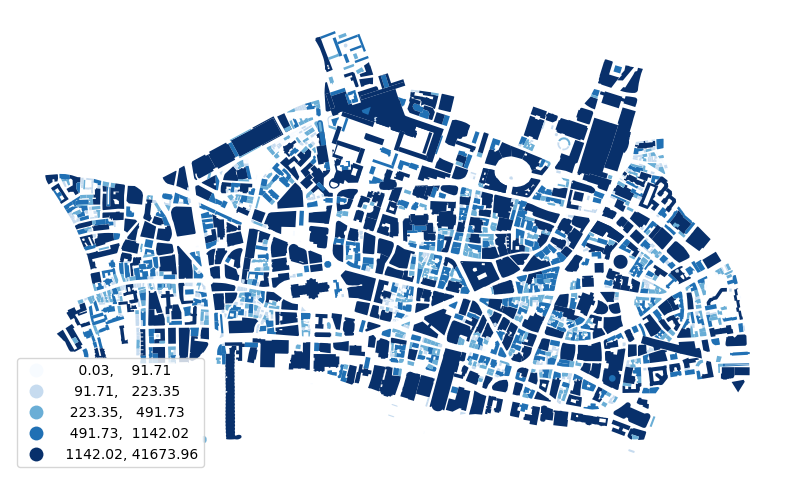

In [ ]:
f, ax = plt.subplots(figsize=(10, 10))
buildings.plot('area', ax=ax, legend=True, scheme='quantiles', cmap='Blues',
               legend_kwds={'loc': 'lower left'})
ax.set_axis_off()
plt.show()

C:\Users\neetm\anaconda3\envs\geopandas_env\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(
C:\Users\neetm\anaconda3\envs\geopandas_env\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


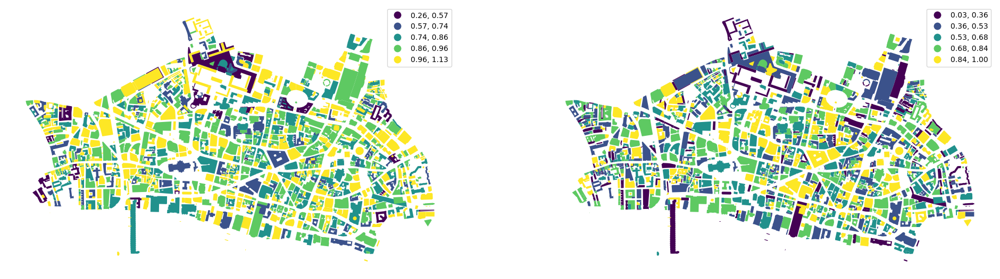

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))

buildings.plot("eri", ax=ax[0], scheme="natural_breaks", legend=True)
buildings.plot("elongation", ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()

C:\Users\neetm\anaconda3\envs\geopandas_env\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(
C:\Users\neetm\anaconda3\envs\geopandas_env\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


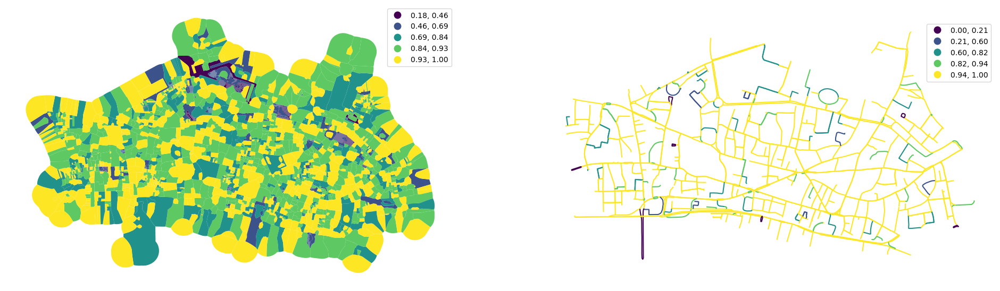

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))

tessellation.plot("convexity", ax=ax[0], scheme="natural_breaks", legend=True)
streets.plot("linearity", ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()